In [3]:
import os

import pysd
import pysd_package.vis as vis
import pickle

import numpy as np
import matplotlib.pyplot as plt
import matplotlib

In [4]:
rundir = "no5"
Ts = ["0.01", "0.1", "1", "2", "4", "8"]
visibleTs = ["0.01", "1", "2", "4", "8"]
DMs = [0 ,0.1, 0.2, 0.4, 0.6, 0.8, 1, 1.2, 1.4, 1.6, 1.7, 1.75, 1.8, 2, 2.5]
DMs2 = [0, 0.2, 1, 1.5, 1.6, 1.7, 2]
DMs3 = [0, 0.05, 0.2, 0.4, 0.8, 1, 1.2, 1.5, 1.6, 1.7, 2]
cmap = matplotlib.cm.get_cmap('bwr')
mRyToTesla = 235.0314 # 1 mRy ~ 235 Tesla for a spin with muB magnetic moment


In [5]:
def plot_hyst_by_T(dm):
    fig = plt.figure(figsize=(5, 4), dpi=400)
    i = 0
    for T in visibleTs:
        with open(os.path.join(rundir, T, str(dm), "experiment.out"), "rb") as fp:
            exp = pickle.load(fp)
        hs = [x.hz for x in exp['configs']]
        hs.extend(hs[::-1])
        ms = [x.avg_M()[2] for x in exp['restartfiles']]
        ms.extend([-m for m in ms])
#         print(hs, ms)
        plt.plot(np.array(hs)/mRyToTesla, ms, label="{} K".format(T), color=cmap(i/(len(visibleTs))))
        i += 1
#     plt.vlines(0, -1, 1, color="black")
    plt.grid()
    plt.legend()
    plt.title("Hysteresis loop at various temperatures for D={}".format(dm))
    plt.xlabel("H [arb]")
    plt.ylabel(r"$\mathrm{M_z/|M|}$")

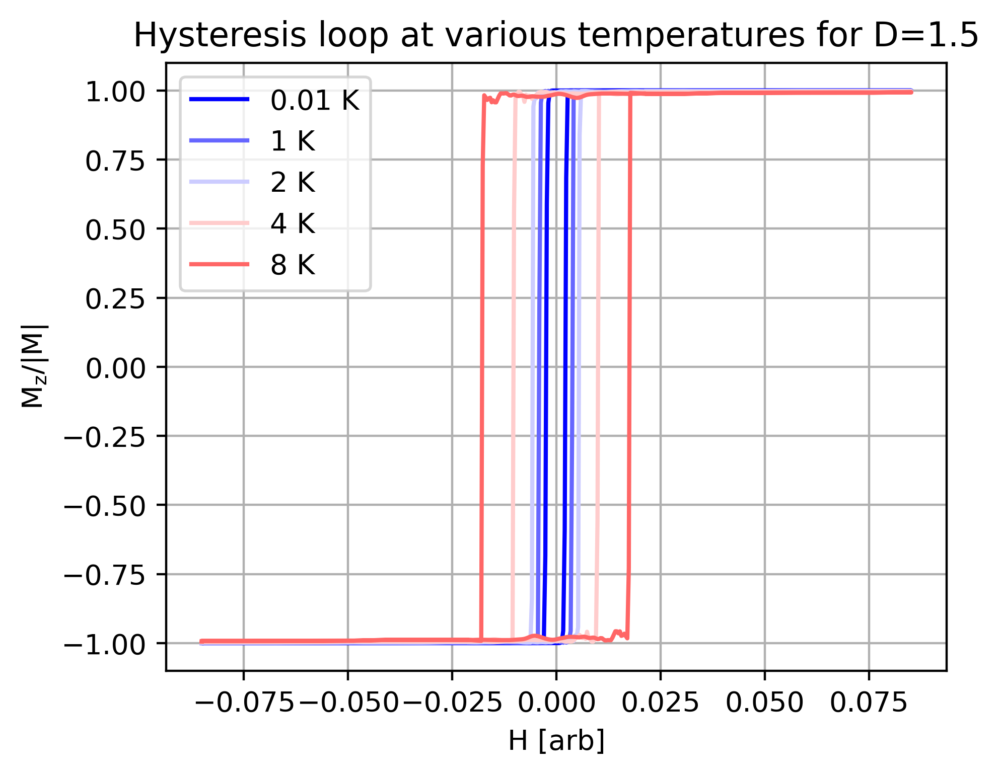

In [6]:
plot_hyst_by_T(1.5)

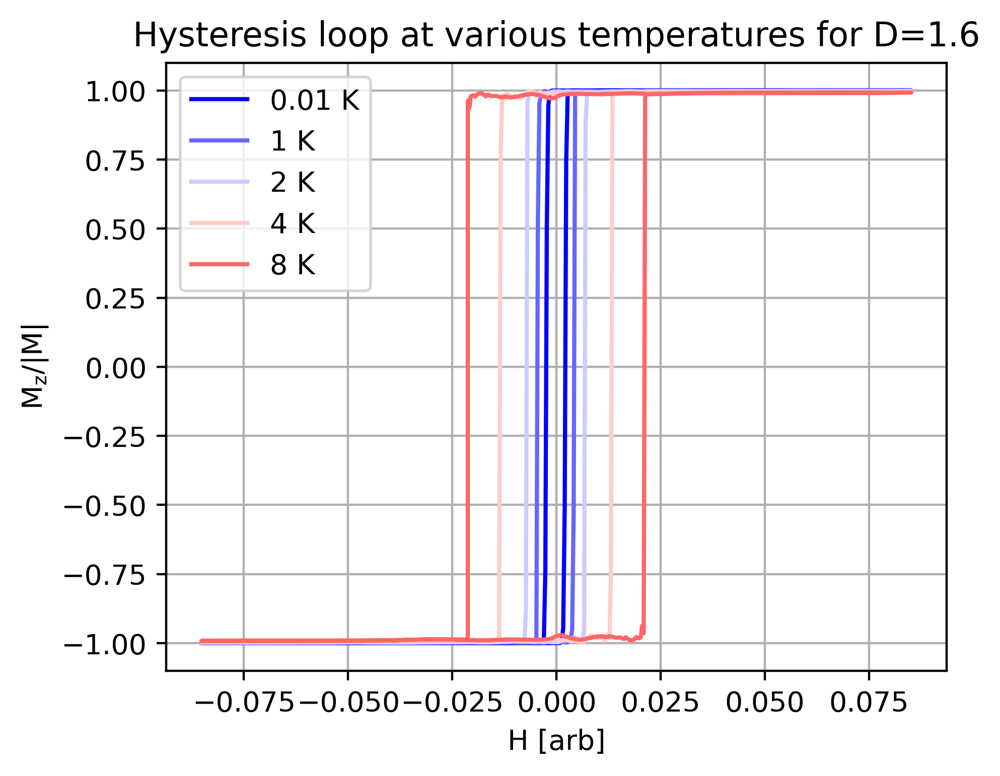

In [7]:
plot_hyst_by_T(1.6)

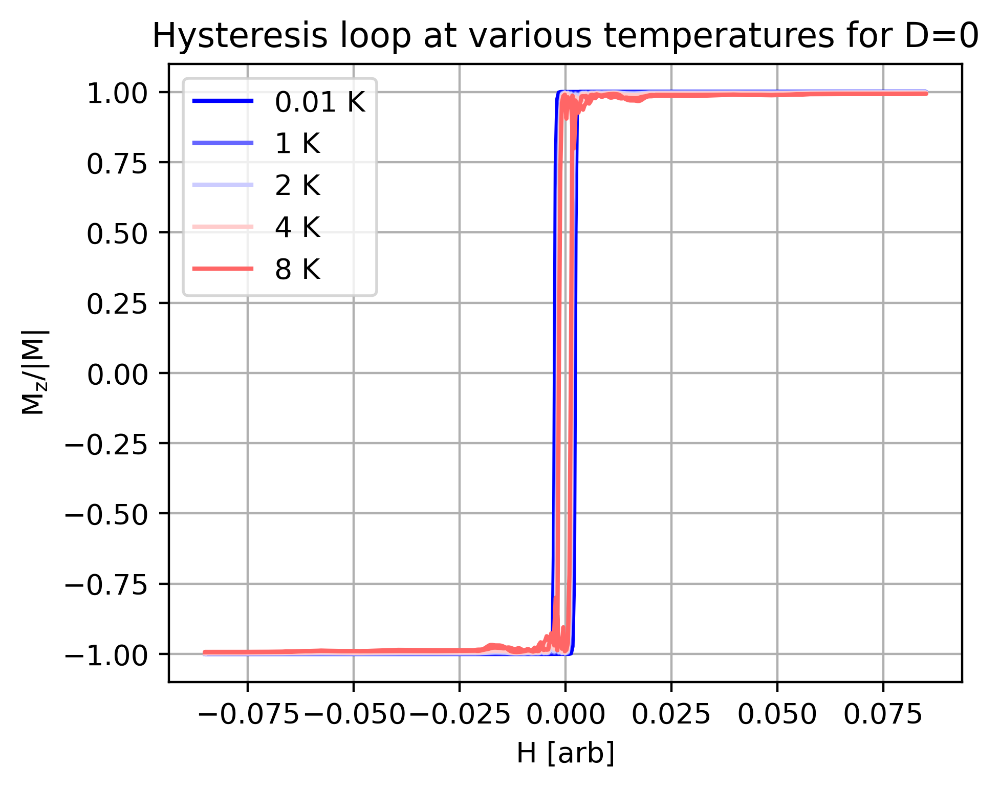

In [8]:
plot_hyst_by_T(0)

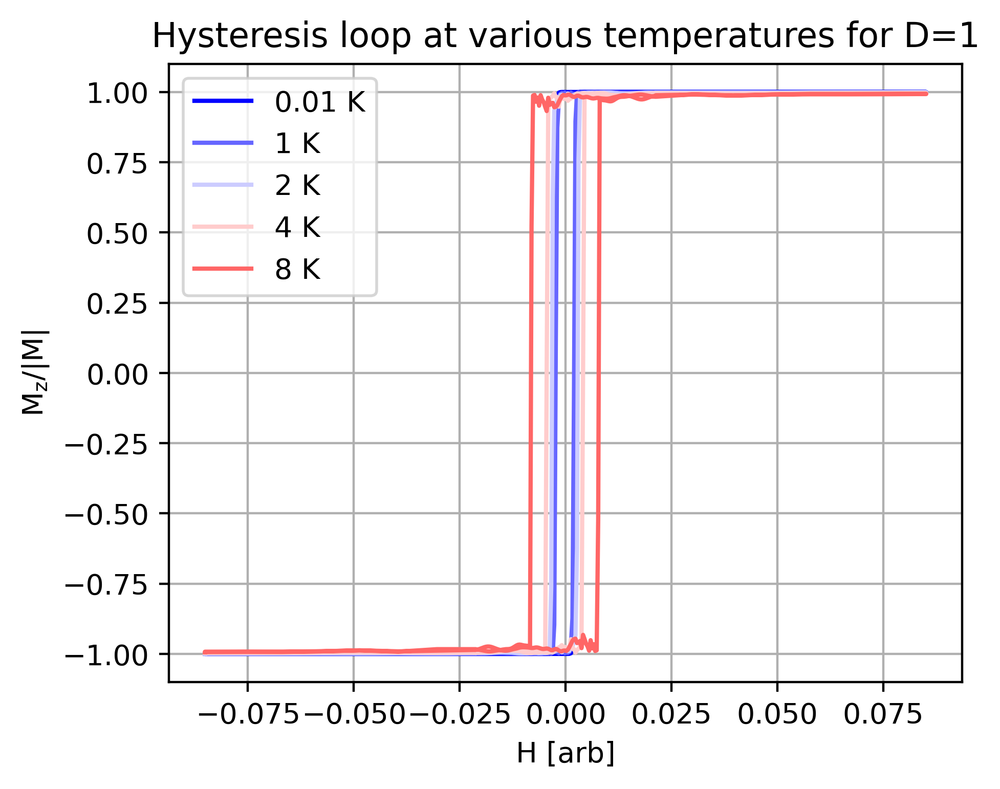

In [9]:
plot_hyst_by_T(1)

In [64]:

rundir = "no1"

/home/jp/.local/lib/python3.8/site-packages/matplotlib/animation.py:889: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you have outputted the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


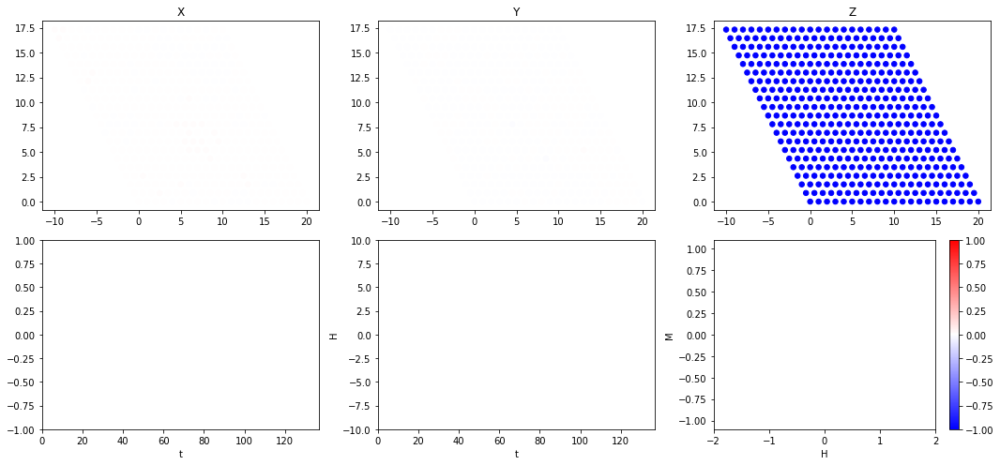

In [62]:
with open(os.path.join(rundir, "0.01", str(0), "experiment.out"), "rb") as fp:
    exp = pickle.load(fp)

anim = vis.anim_mag_overview(exp['coordfile'], exp['restartfiles'], exp['configs'], "")

In [131]:
from IPython import display
display.HTML(anim.to_jshtml())


Text(0, 0.5, '$\\mathrm{M_z/|M|}$')

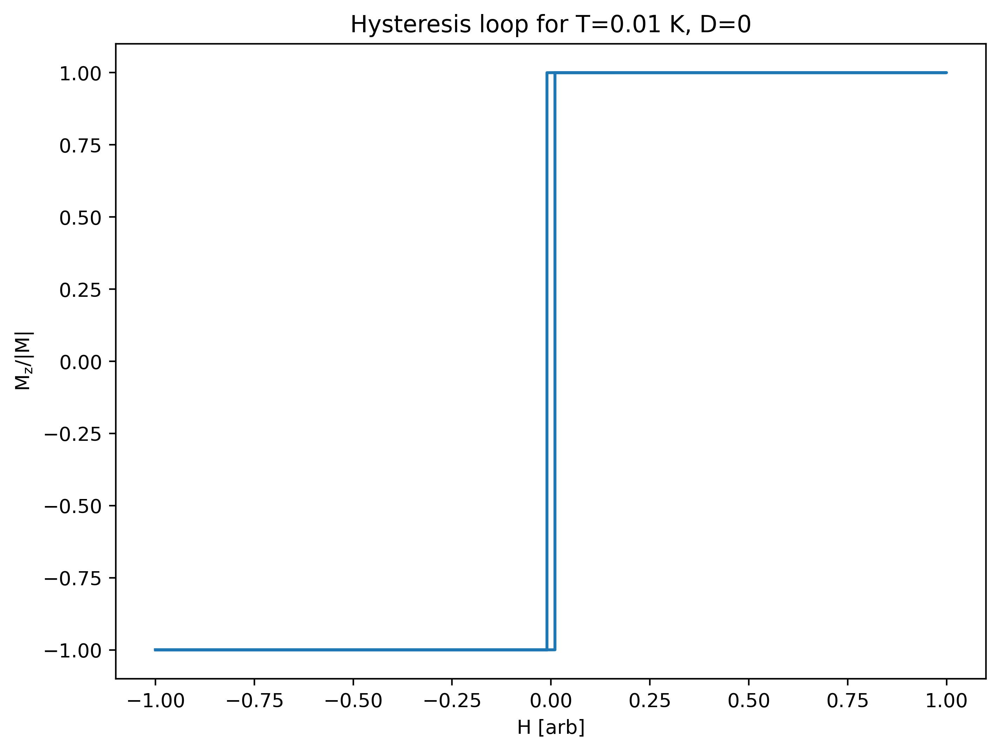

In [67]:
with open(os.path.join(rundir, "0.01", str(0), "experiment.out"), "rb") as fp:
    exp = pickle.load(fp)
    
hs = [x.hz for x in exp['configs']]
ms = [x.avg_M()[2] for x in exp['restartfiles']]
fig = plt.figure(figsize=(8, 6), dpi=400)
plt.plot(np.array(hs)/mRyToTesla, ms)
# plt.savefig("hysteresis.png")
plt.title("Hysteresis loop for T=0.01 K, D=0")
plt.xlabel("H [arb]")
plt.ylabel(r"$\mathrm{M_z/|M|}$")

Text(0, 0.5, '$\\mathrm{M_z/|M|}$')

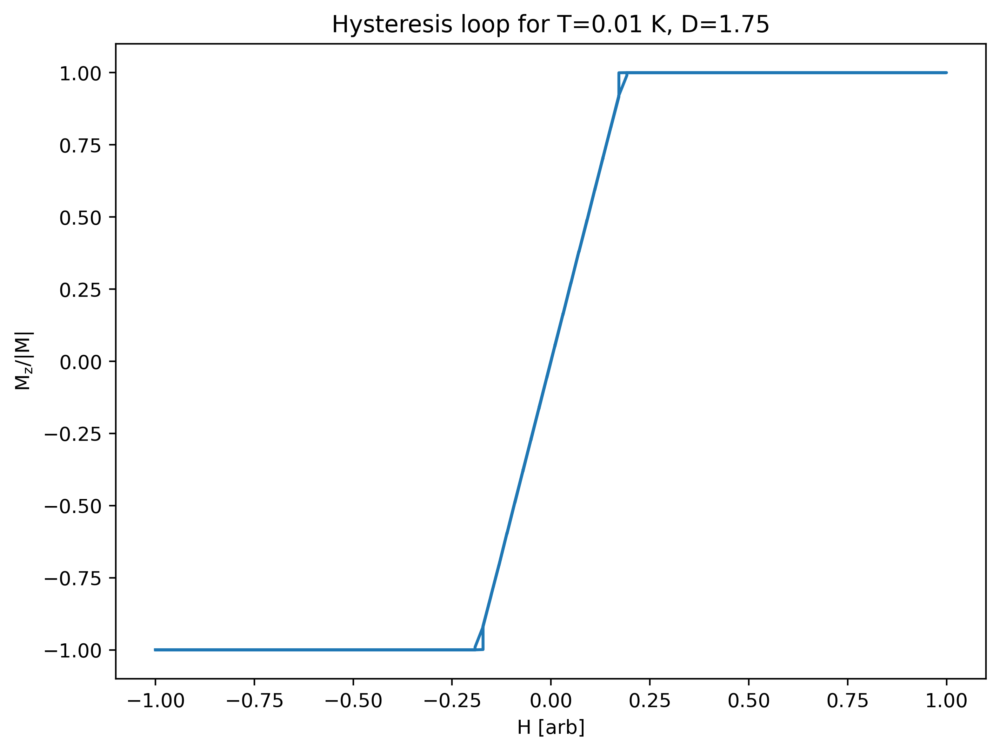

In [71]:
with open(os.path.join(rundir, "0.01", str(1.75), "experiment.out"), "rb") as fp:
    exp = pickle.load(fp)


hs = [x.hz for x in exp['configs']]
ms = [x.avg_M()[2] for x in exp['restartfiles']]
fig = plt.figure(figsize=(8, 6), dpi=400)
plt.plot(np.array(hs)/mRyToTesla, ms)
# plt.savefig("hysteresis.png")
plt.title("Hysteresis loop for T=0.01 K, D=1.75")
plt.xlabel("H [arb]")
plt.ylabel(r"$\mathrm{M_z/|M|}$")

In [17]:
def plot_hyst_mag():
    xs = DMs3
    ys = {}
    plt.figure(figsize=(8, 6), dpi=400)
    j = 0
    for T in Ts:
        ys[T] = []
        for dm in DMs3:
            try:
                with open(os.path.join(rundir, T, str(dm), "experiment.out"), "rb") as fp:
                    exp = pickle.load(fp)
                for i in range(len(exp['configs'])):
                    if exp['restartfiles'][i].avg_M()[2] > 0:
                        ys[T].append(exp['configs'][i].hz)
                        break
            except:
                ys[T].append(0)
    
        plt.plot(xs, ys[T], label="T={} K".format(T), color=cmap(j/(len(Ts)+1)))
        plt.xlim(0, 1.7)
        j += 1
    plt.grid()
    plt.legend()
    plt.title("Coercivity on DM interaction strength for different temperatures")
    plt.xlabel("D [arb]")
    plt.ylabel("H [arb]")

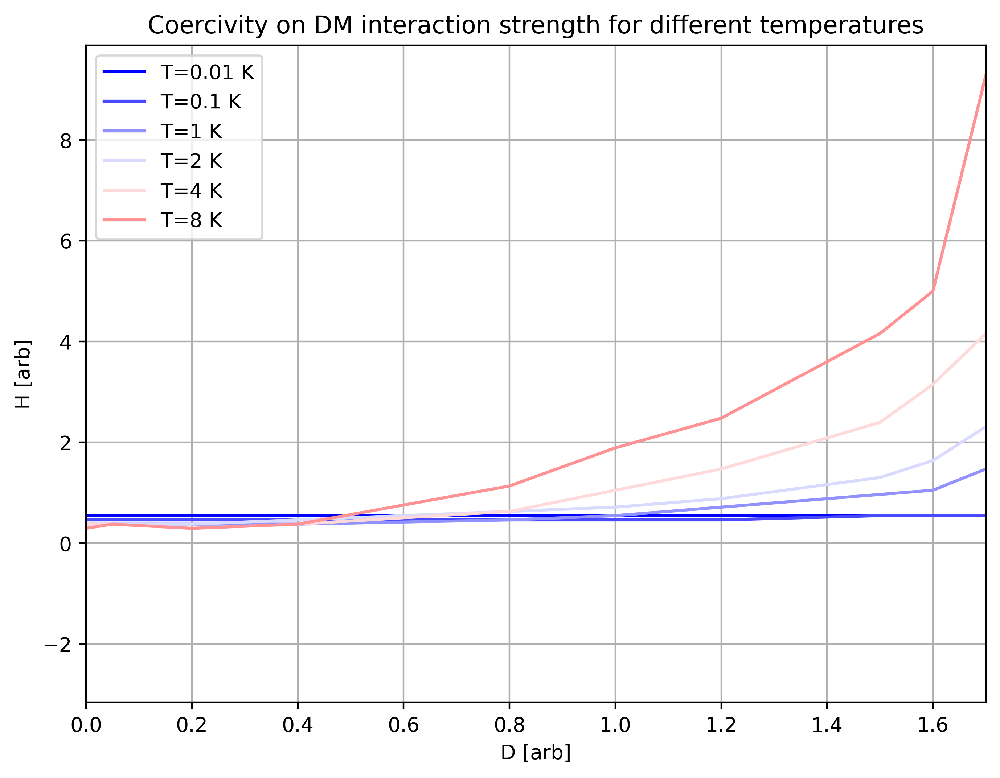

In [18]:
plot_hyst_mag()